In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
# --- CELL 1: LIBRARIES ---
print("Step 1: Installing libraries...")
!pip install numpy<2" "opencv-python==4.8.0.76" timm albumentations grad-cam -q
!pip install torch_geometric pyg_lib torch_scatter torch_sparse torch_cluster torch_spline_conv -f https://data.pyg.org/whl/torch-2.0.0+cu118.html -q

import os
import cv2
import math
import random
import gc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from glob import glob
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from torch.cuda.amp import autocast, GradScaler
import albumentations as A
from albumentations.pytorch import ToTensorV2
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import cohen_kappa_score, accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import label_binarize
import timm
from torch_geometric.nn import MessagePassing
import networkx as nx
import warnings
warnings.filterwarnings("ignore")

print(" Libraries installed & imported.")


Step 1: Installing libraries...
/bin/bash: -c: line 1: unexpected EOF while looking for matching `"'
/bin/bash: -c: line 2: syntax error: unexpected end of file
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 29.9 MB/s eta 0:00:0000:010:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 110.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 40.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 100.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 886.5/886.5 kB 55.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 24.7 MB/s eta 0:00:00a 0:00:01


/usr/local/lib/python3.11/dist-packages/pydantic/_internal/_generate_schema.py:2249: UnsupportedFieldAttributeWarning: The 'repr' attribute with value False was provided to the `Field()` function, which has no effect in the context it was used. 'repr' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` statement was used, or if the `Field()` function was attached to a single member of a union type.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/pydantic/_internal/_generate_schema.py:2249: UnsupportedFieldAttributeWarning: The 'frozen' attribute with value True was provided to the `Field()` function, which has no effect in the context it was used. 'frozen' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` 

 Libraries installed & imported.


In [2]:
# --- CELL 2: CONFIGURATION ---
def seed_everything(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

seed_everything(42)

class CFG:
    IMG_SIZE = 224
    BATCH_SIZE = 8
    LR = 1e-4
    EPOCHS = 30
    SEED = 42
    NUM_CLASSES = 4
    DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    N_SPLITS = 3
    DATA_DIR = "/kaggle/input/mri-dataset-224/MRI_T2_224_Combined" 

print(f"✅ Config ready on {CFG.DEVICE}")

✅ Config ready on cuda


In [3]:
# --- CELL 3: DATA PREPARATION (FIXED: trainval_df + held-out test_df) ---
from sklearn.model_selection import train_test_split
from glob import glob
import os
import pandas as pd

class_map = {"F0": 0, "F1": 1, "F2": 2, "F3": 3}
image_paths, labels = [], []

for folder, label in class_map.items():
    folder_path = os.path.join(CFG.DATA_DIR, folder)
    imgs = glob(os.path.join(folder_path, "*.png"))
    image_paths.extend(imgs)
    labels.extend([label] * len(imgs))

df = pd.DataFrame({"image_path": image_paths, "diagnosis": labels})
df = df.sample(frac=1, random_state=CFG.SEED).reset_index(drop=True)

print(f"✅ Loaded {len(df)} images (TOTAL).")
print("Class distribution (TOTAL):")
print(df["diagnosis"].value_counts())

# ✅ IMPORTANT: make HELD-OUT TEST SET (never used in CV training)
trainval_df, test_df = train_test_split(
    df,
    test_size=0.20,                 # 20% test (you can use 0.15 too)
    stratify=df["diagnosis"],
    random_state=CFG.SEED
)

trainval_df = trainval_df.reset_index(drop=True)
test_df     = test_df.reset_index(drop=True)

print("\n✅ Split created:")
print(f"Train+Val (CV) size: {len(trainval_df)}")
print(f"TEST (held-out) size: {len(test_df)}")

print("\nClass distribution (Train+Val):")
print(trainval_df["diagnosis"].value_counts())

print("\nClass distribution (Test):")
print(test_df["diagnosis"].value_counts())


✅ Loaded 10854 images (TOTAL).
Class distribution (TOTAL):
diagnosis
2    3483
1    3280
0    2185
3    1906
Name: count, dtype: int64

✅ Split created:
Train+Val (CV) size: 8683
TEST (held-out) size: 2171

Class distribution (Train+Val):
diagnosis
2    2786
1    2624
0    1748
3    1525
Name: count, dtype: int64

Class distribution (Test):
diagnosis
2    697
1    656
0    437
3    381
Name: count, dtype: int64


In [4]:
# --- CELL 4: PREPROCESSING ---
def preprocess_for_model(path):
    img = cv2.imread(path)
    if img is None: return np.zeros((CFG.IMG_SIZE, CFG.IMG_SIZE, 3), dtype=np.uint8)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Denoise + CLAHE + Sharpen (Standard Pipeline)
    img = cv2.medianBlur(img, 3)
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l = clahe.apply(l)
    img = cv2.cvtColor(cv2.merge((l, a, b)), cv2.COLOR_LAB2RGB)
    kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
    img = cv2.filter2D(img, -1, kernel)
    return img

print(" Preprocessing pipeline defined.")

 Preprocessing pipeline defined.


🚀 Generating High-Res Visualization for Cell 4 Pipeline...
🖼️ Visualizing Class F1 | File: /kaggle/input/mri-dataset-224/MRI_T2_224_Combined/F1/458_t2_slice030.png


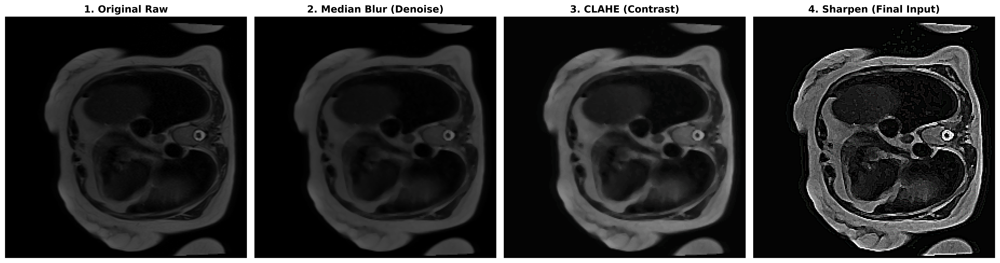

✅ Visualization complete.


In [5]:
# ==========================================
# High-Res Preprocessing Visualization (Cell 4 Logic)
# ==========================================
import cv2
import numpy as np
import matplotlib.pyplot as plt

print("🚀 Generating High-Res Visualization for Cell 4 Pipeline...")

def visualize_cell4_preprocessing(image_path):
    # 1. Load Original
    img = cv2.imread(image_path)
    if img is None:
        print(f"❌ Could not load image: {image_path}")
        return

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # --- STEP 1: Median Blur (Denoise) ---
    img_denoised = cv2.medianBlur(img_rgb, 3)

    # --- STEP 2: CLAHE (Contrast) ---
    lab = cv2.cvtColor(img_denoised, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l_clahe = clahe.apply(l)
    img_clahe = cv2.cvtColor(cv2.merge((l_clahe, a, b)), cv2.COLOR_LAB2RGB)

    # --- STEP 3: Sharpen ---
    kernel = np.array([[-1,-1,-1], 
                       [-1, 9,-1], 
                       [-1,-1,-1]])
    img_sharp = cv2.filter2D(img_clahe, -1, kernel)

    # ==========================================
    # Plotting (DPI=600)
    # ==========================================
    fig, axes = plt.subplots(1, 4, figsize=(20, 6), dpi=600)
    
    titles = [
        "1. Original Raw", 
        "2. Median Blur (Denoise)", 
        "3. CLAHE (Contrast)", 
        "4. Sharpen (Final Input)"
    ]
    images = [img_rgb, img_denoised, img_clahe, img_sharp]

    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img)
        ax.set_title(title, fontsize=14, fontweight='bold')
        ax.axis('off')

    plt.tight_layout()
    plt.show()
    print("✅ Visualization complete.")

# ==========================================
# Run on a Random Image
# ==========================================
# Uses 'df' or 'train_val_df' if available from your notebook context
target_df = df if 'df' in locals() else train_val_df

if len(target_df) > 0:
    # Pick 1 random sample
    random_row = target_df.sample(1).iloc[0]
    sample_path = random_row['image_path']
    true_diagnosis = random_row['diagnosis']
    
    print(f"🖼️ Visualizing Class F{true_diagnosis} | File: {sample_path}")
    visualize_cell4_preprocessing(sample_path)
else:
    print("⚠️ DataFrame not found. Please provide a manual path like: visualize_cell4_preprocessing('path/to/img.jpg')")

In [6]:
# --- CELL 5: DATASET ---
MEAN = [0.485, 0.456, 0.406]
STD  = [0.229, 0.224, 0.225]

train_tfms = A.Compose([
    A.Resize(CFG.IMG_SIZE, CFG.IMG_SIZE),
    A.Rotate(limit=15, p=0.5),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.2),
    A.RandomBrightnessContrast(p=0.2),
    A.Normalize(mean=MEAN, std=STD),
    ToTensorV2()
])

valid_tfms = A.Compose([
    A.Resize(CFG.IMG_SIZE, CFG.IMG_SIZE),
    A.Normalize(mean=MEAN, std=STD),
    ToTensorV2()
])

class LiverDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df
        self.transform = transform
    def __len__(self): return len(self.df)
    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img = preprocess_for_model(row.image_path)
        if self.transform: img = self.transform(image=img)["image"]
        return img, torch.tensor(int(row.diagnosis), dtype=torch.long)

print(" Dataset class ready.")


 Dataset class ready.


In [7]:
# --- CELL 6: DENSENET + GRID SGN MODEL (k = 5) ---

import torch
import torch.nn as nn
import torch.nn.functional as F
import timm

# --------- GRID ADJACENCY (k = 5) ----------
def build_grid_adjacency_k5(h, w, device):
    """
    Grid adjacency with k=5:
    Self + 4-connected neighbors (up, down, left, right)
    """
    N = h * w
    A = torch.zeros((N, N), device=device)

    for y in range(h):
        for x in range(w):
            idx = y * w + x

            neighbors = [
                (y, x),        # self
                (y, x - 1),    # left
                (y, x + 1),    # right
                (y - 1, x),    # up
                (y + 1, x),    # down
            ]

            for ny, nx in neighbors:
                if 0 <= ny < h and 0 <= nx < w:
                    j = ny * w + nx
                    A[idx, j] = 1.0

    # Symmetric normalization: D^-1/2 A D^-1/2
    deg = A.sum(dim=1)
    deg_inv_sqrt = (deg + 1e-6).pow(-0.5)
    D_inv_sqrt = torch.diag(deg_inv_sqrt)

    return D_inv_sqrt @ A @ D_inv_sqrt


# --------- SGN LAYER ----------
class SpatialGraphConv(nn.Module):
    """
    SGN Layer:
    Out = W_self * X + W_neigh * (A @ X)
    """
    def __init__(self, in_channels, out_channels, dropout=0.2):
        super().__init__()
        self.lin_self = nn.Linear(in_channels, out_channels, bias=False)
        self.lin_neigh = nn.Linear(in_channels, out_channels, bias=False)
        self.bn = nn.BatchNorm1d(out_channels)
        self.dropout = nn.Dropout(dropout)
        self.act = nn.ReLU()

    def forward(self, x, adj):
        # x: (B, N, C)
        x_neigh = torch.matmul(adj, x)   # (B, N, C)

        out = self.lin_self(x) + self.lin_neigh(x_neigh)

        # BatchNorm expects (B, C, N)
        out = out.permute(0, 2, 1)
        out = self.bn(out)
        out = out.permute(0, 2, 1)

        return self.act(self.dropout(out))


# --------- DENSENET + SGN ----------
class DenseNetGridSGN(nn.Module):
    def __init__(self, num_classes=4):
        super().__init__()

        self.cnn = timm.create_model(
            "densenet121",
            pretrained=True,
            num_classes=0,
            global_pool=""
        )

        in_ch = self.cnn.num_features

        # SGN layers
        self.sgn1 = SpatialGraphConv(in_ch, 512, dropout=0.3)
        self.sgn2 = SpatialGraphConv(512, 256, dropout=0.3)

        self.fc = nn.Linear(256, num_classes)

        # adjacency buffer
        self.register_buffer("adj", torch.empty(0), persistent=False)

    def _get_features(self, x):
        return self.cnn.forward_features(x)

    # ---------- XAI HOOK ----------
    def get_graph_activations(self, x):
        feat = self._get_features(x)
        B, C, H, W = feat.shape
        N = H * W

        x_nodes = feat.view(B, C, N).permute(0, 2, 1)

        if self.adj.numel() == 0 or self.adj.shape[0] != N:
            self.adj = build_grid_adjacency_k5(H, W, feat.device)

        adj = self.adj.to(x.dtype)

        h = self.sgn1(x_nodes, adj)
        h = self.sgn2(h, adj)

        return h.norm(dim=2).view(B, H, W)

    def forward(self, x):
        feat = self._get_features(x)
        B, C, H, W = feat.shape
        N = H * W

        x_nodes = feat.view(B, C, N).permute(0, 2, 1)

        if self.adj.numel() == 0 or self.adj.shape[0] != N:
            self.adj = build_grid_adjacency_k5(H, W, feat.device)

        adj = self.adj.to(x.dtype)

        h = self.sgn1(x_nodes, adj)
        h = self.sgn2(h, adj)

        graph_feat = h.mean(dim=1)
        return self.fc(graph_feat)


print("✅ DenseNet + Grid SGN (k = 5) Model Defined.")


✅ DenseNet + Grid SGN (k = 5) Model Defined.


In [8]:
# --- CELL 7: UTILS (FIXED: CV splits on trainval_df, not df) ---
class FocalLoss(nn.Module):
    def __init__(self, alpha=1.0, gamma=2.0):
        super().__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.ce = nn.CrossEntropyLoss(reduction="none")

    def forward(self, inputs, targets):
        ce_loss = self.ce(inputs, targets)
        pt = torch.exp(-ce_loss)
        return (self.alpha * (1 - pt) ** self.gamma * ce_loss).mean()

skf = StratifiedKFold(n_splits=CFG.N_SPLITS, shuffle=True, random_state=CFG.SEED)

# ✅ IMPORTANT: split ONLY on trainval_df
splits = list(skf.split(trainval_df, trainval_df["diagnosis"]))

print("✅ Utils ready.")
print(f"✅ CV splits created on trainval_df (n_splits={CFG.N_SPLITS})")


✅ Utils ready.
✅ CV splits created on trainval_df (n_splits=3)


In [9]:
# --- CELL 8: TRAINING LOOP (FIXED: train on trainval_df folds only) ---
def train_fold(fold, train_idx, val_idx):
    print(f"\n===== FOLD {fold+1}/{CFG.N_SPLITS} =====")

    # ✅ Use trainval_df (NOT df)
    train_sub = trainval_df.iloc[train_idx].reset_index(drop=True)
    val_sub   = trainval_df.iloc[val_idx].reset_index(drop=True)

    # Weighted sampler for imbalance
    counts = train_sub.diagnosis.value_counts().to_dict()
    weights = [1.0 / counts[label] for label in train_sub.diagnosis]
    sampler = WeightedRandomSampler(weights, len(weights), replacement=True)

    train_loader = DataLoader(
        LiverDataset(train_sub, train_tfms),
        batch_size=CFG.BATCH_SIZE,
        sampler=sampler,
        num_workers=2
    )

    val_loader = DataLoader(
        LiverDataset(val_sub, valid_tfms),
        batch_size=CFG.BATCH_SIZE,
        shuffle=False,
        num_workers=2
    )

    model = DenseNetGridSGN(CFG.NUM_CLASSES).to(CFG.DEVICE)
    optimizer = optim.AdamW(model.parameters(), lr=CFG.LR, weight_decay=1e-4)
    scaler = GradScaler()
    criterion = FocalLoss()
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', patience=2, factor=0.5
    )

    best_qwk = -1.0

    for epoch in range(CFG.EPOCHS):
        # ---- train ----
        model.train()
        train_loss = 0.0

        for img, label in tqdm(train_loader, desc=f"Fold {fold+1} Ep {epoch+1}", leave=False):
            img, label = img.to(CFG.DEVICE), label.to(CFG.DEVICE)
            optimizer.zero_grad()

            with autocast():
                out = model(img)
                loss = criterion(out, label)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
            train_loss += loss.item()

        # ---- validate ----
        model.eval()
        preds, acts = [], []

        with torch.no_grad():
            for img, label in val_loader:
                img, label = img.to(CFG.DEVICE), label.to(CFG.DEVICE)
                with autocast():
                    out = model(img)

                preds.extend(torch.argmax(out, 1).cpu().numpy())
                acts.extend(label.cpu().numpy())

        qwk = cohen_kappa_score(acts, preds, weights='quadratic')
        acc = accuracy_score(acts, preds)

        print(f"Ep {epoch+1}: Loss={train_loss/len(train_loader):.4f} | ValAcc={acc:.4f} | ValQWK={qwk:.4f}")
        scheduler.step(qwk)

        if qwk > best_qwk:
            best_qwk = qwk
            torch.save(model.state_dict(), f"sgn_fold{fold+1}.pth")
            print(f"--> ⭐ Saved Best Fold {fold+1} QWK: {best_qwk:.4f}")

    return best_qwk


fold_scores = []
for i, (t_idx, v_idx) in enumerate(splits):
    score = train_fold(i, t_idx, v_idx)
    fold_scores.append(score)

print("\n✅ Training Done.")
print(f"✅ Avg CV QWK: {np.mean(fold_scores):.4f}")
print("✅ Saved weights: sgn_fold1.pth, sgn_fold2.pth, sgn_fold3.pth")
print("✅ Held-out test_df exists and was NEVER used in training.")



===== FOLD 1/3 =====


model.safetensors:   0%|          | 0.00/32.3M [00:00<?, ?B/s]

Ep 1: Loss=0.4989 | ValAcc=0.6860 | ValQWK=0.7771
--> ⭐ Saved Best Fold 1 QWK: 0.7771


Ep 2: Loss=0.3333 | ValAcc=0.7523 | ValQWK=0.7999
--> ⭐ Saved Best Fold 1 QWK: 0.7999


Ep 3: Loss=0.2714 | ValAcc=0.7838 | ValQWK=0.8397
--> ⭐ Saved Best Fold 1 QWK: 0.8397


Ep 4: Loss=0.2115 | ValAcc=0.7914 | ValQWK=0.8512
--> ⭐ Saved Best Fold 1 QWK: 0.8512


Ep 5: Loss=0.1951 | ValAcc=0.8166 | ValQWK=0.8679
--> ⭐ Saved Best Fold 1 QWK: 0.8679


Ep 6: Loss=0.1633 | ValAcc=0.8535 | ValQWK=0.9013
--> ⭐ Saved Best Fold 1 QWK: 0.9013


Ep 7: Loss=0.1401 | ValAcc=0.8508 | ValQWK=0.8981


Ep 8: Loss=0.1227 | ValAcc=0.8753 | ValQWK=0.9064
--> ⭐ Saved Best Fold 1 QWK: 0.9064


Ep 9: Loss=0.1172 | ValAcc=0.9105 | ValQWK=0.9462
--> ⭐ Saved Best Fold 1 QWK: 0.9462


Ep 10: Loss=0.0997 | ValAcc=0.9147 | ValQWK=0.9321


Ep 11: Loss=0.0963 | ValAcc=0.9067 | ValQWK=0.9276


Ep 12: Loss=0.0815 | ValAcc=0.9140 | ValQWK=0.9352


Ep 13: Loss=0.0597 | ValAcc=0.9534 | ValQWK=0.9655
--> ⭐ Saved Best Fold 1 QWK: 0.9655


Ep 14: Loss=0.0438 | ValAcc=0.9561 | ValQWK=0.9680
--> ⭐ Saved Best Fold 1 QWK: 0.9680


Ep 15: Loss=0.0461 | ValAcc=0.9585 | ValQWK=0.9673


Ep 16: Loss=0.0388 | ValAcc=0.9603 | ValQWK=0.9737
--> ⭐ Saved Best Fold 1 QWK: 0.9737


Ep 17: Loss=0.0318 | ValAcc=0.9575 | ValQWK=0.9711


Ep 18: Loss=0.0348 | ValAcc=0.9530 | ValQWK=0.9661


Ep 19: Loss=0.0274 | ValAcc=0.9689 | ValQWK=0.9742
--> ⭐ Saved Best Fold 1 QWK: 0.9742


Ep 20: Loss=0.0328 | ValAcc=0.9655 | ValQWK=0.9687


Ep 21: Loss=0.0274 | ValAcc=0.9696 | ValQWK=0.9802
--> ⭐ Saved Best Fold 1 QWK: 0.9802


Ep 22: Loss=0.0287 | ValAcc=0.9682 | ValQWK=0.9769


Ep 23: Loss=0.0291 | ValAcc=0.9655 | ValQWK=0.9743


Ep 24: Loss=0.0276 | ValAcc=0.9658 | ValQWK=0.9768


Ep 25: Loss=0.0209 | ValAcc=0.9769 | ValQWK=0.9846
--> ⭐ Saved Best Fold 1 QWK: 0.9846


Ep 26: Loss=0.0127 | ValAcc=0.9737 | ValQWK=0.9825


Ep 27: Loss=0.0134 | ValAcc=0.9793 | ValQWK=0.9832


Ep 28: Loss=0.0119 | ValAcc=0.9831 | ValQWK=0.9900
--> ⭐ Saved Best Fold 1 QWK: 0.9900


Ep 29: Loss=0.0116 | ValAcc=0.9769 | ValQWK=0.9841


Ep 30: Loss=0.0116 | ValAcc=0.9810 | ValQWK=0.9859

===== FOLD 2/3 =====


Ep 1: Loss=0.4977 | ValAcc=0.6659 | ValQWK=0.7584
--> ⭐ Saved Best Fold 2 QWK: 0.7584


Ep 2: Loss=0.3322 | ValAcc=0.7478 | ValQWK=0.8156
--> ⭐ Saved Best Fold 2 QWK: 0.8156


Ep 3: Loss=0.2592 | ValAcc=0.7961 | ValQWK=0.8343
--> ⭐ Saved Best Fold 2 QWK: 0.8343


Ep 4: Loss=0.2191 | ValAcc=0.8376 | ValQWK=0.8717
--> ⭐ Saved Best Fold 2 QWK: 0.8717


Ep 5: Loss=0.1805 | ValAcc=0.8314 | ValQWK=0.8705


Ep 6: Loss=0.1564 | ValAcc=0.8659 | ValQWK=0.8930
--> ⭐ Saved Best Fold 2 QWK: 0.8930


Ep 7: Loss=0.1418 | ValAcc=0.8818 | ValQWK=0.9004
--> ⭐ Saved Best Fold 2 QWK: 0.9004


Ep 8: Loss=0.1268 | ValAcc=0.9060 | ValQWK=0.9254
--> ⭐ Saved Best Fold 2 QWK: 0.9254


Ep 9: Loss=0.1129 | ValAcc=0.8929 | ValQWK=0.9208


Ep 10: Loss=0.1001 | ValAcc=0.9088 | ValQWK=0.9185


Ep 11: Loss=0.0816 | ValAcc=0.9191 | ValQWK=0.9328
--> ⭐ Saved Best Fold 2 QWK: 0.9328


Ep 12: Loss=0.0904 | ValAcc=0.9274 | ValQWK=0.9386
--> ⭐ Saved Best Fold 2 QWK: 0.9386


Ep 13: Loss=0.0831 | ValAcc=0.9126 | ValQWK=0.9251


Ep 14: Loss=0.0692 | ValAcc=0.9388 | ValQWK=0.9425
--> ⭐ Saved Best Fold 2 QWK: 0.9425


Ep 15: Loss=0.0689 | ValAcc=0.9330 | ValQWK=0.9407


Ep 16: Loss=0.0710 | ValAcc=0.9316 | ValQWK=0.9481
--> ⭐ Saved Best Fold 2 QWK: 0.9481


Ep 17: Loss=0.0611 | ValAcc=0.9337 | ValQWK=0.9401


Ep 18: Loss=0.0705 | ValAcc=0.9292 | ValQWK=0.9379


Ep 19: Loss=0.0517 | ValAcc=0.9516 | ValQWK=0.9503
--> ⭐ Saved Best Fold 2 QWK: 0.9503


Ep 20: Loss=0.0505 | ValAcc=0.9406 | ValQWK=0.9487


Ep 21: Loss=0.0546 | ValAcc=0.9461 | ValQWK=0.9480


Ep 22: Loss=0.0456 | ValAcc=0.9520 | ValQWK=0.9597
--> ⭐ Saved Best Fold 2 QWK: 0.9597


Ep 23: Loss=0.0466 | ValAcc=0.9385 | ValQWK=0.9433


Ep 24: Loss=0.0412 | ValAcc=0.9509 | ValQWK=0.9434


Ep 25: Loss=0.0488 | ValAcc=0.9461 | ValQWK=0.9570


Ep 26: Loss=0.0282 | ValAcc=0.9737 | ValQWK=0.9777
--> ⭐ Saved Best Fold 2 QWK: 0.9777


Ep 27: Loss=0.0215 | ValAcc=0.9703 | ValQWK=0.9760


Ep 28: Loss=0.0162 | ValAcc=0.9772 | ValQWK=0.9774


Ep 29: Loss=0.0160 | ValAcc=0.9682 | ValQWK=0.9682


Ep 30: Loss=0.0116 | ValAcc=0.9782 | ValQWK=0.9775

===== FOLD 3/3 =====


Ep 1: Loss=0.4902 | ValAcc=0.6323 | ValQWK=0.6970
--> ⭐ Saved Best Fold 3 QWK: 0.6970


Ep 2: Loss=0.3448 | ValAcc=0.7066 | ValQWK=0.7824
--> ⭐ Saved Best Fold 3 QWK: 0.7824


Ep 3: Loss=0.2764 | ValAcc=0.7429 | ValQWK=0.8105
--> ⭐ Saved Best Fold 3 QWK: 0.8105


Ep 4: Loss=0.2402 | ValAcc=0.7999 | ValQWK=0.8492
--> ⭐ Saved Best Fold 3 QWK: 0.8492


Ep 5: Loss=0.1960 | ValAcc=0.8538 | ValQWK=0.8936
--> ⭐ Saved Best Fold 3 QWK: 0.8936


Ep 6: Loss=0.1684 | ValAcc=0.8614 | ValQWK=0.8999
--> ⭐ Saved Best Fold 3 QWK: 0.8999


Ep 7: Loss=0.1440 | ValAcc=0.8607 | ValQWK=0.8896


Ep 8: Loss=0.1317 | ValAcc=0.8708 | ValQWK=0.8929


Ep 9: Loss=0.1146 | ValAcc=0.8804 | ValQWK=0.9013
--> ⭐ Saved Best Fold 3 QWK: 0.9013


Ep 10: Loss=0.1021 | ValAcc=0.8663 | ValQWK=0.8916


Ep 11: Loss=0.0986 | ValAcc=0.9188 | ValQWK=0.9362
--> ⭐ Saved Best Fold 3 QWK: 0.9362


Ep 12: Loss=0.0904 | ValAcc=0.8846 | ValQWK=0.8932


Ep 13: Loss=0.0866 | ValAcc=0.9278 | ValQWK=0.9353


Ep 14: Loss=0.0728 | ValAcc=0.8925 | ValQWK=0.9248


Ep 15: Loss=0.0514 | ValAcc=0.9430 | ValQWK=0.9531
--> ⭐ Saved Best Fold 3 QWK: 0.9531


Ep 16: Loss=0.0410 | ValAcc=0.9468 | ValQWK=0.9570
--> ⭐ Saved Best Fold 3 QWK: 0.9570


Ep 17: Loss=0.0372 | ValAcc=0.9554 | ValQWK=0.9622
--> ⭐ Saved Best Fold 3 QWK: 0.9622


Ep 18: Loss=0.0370 | ValAcc=0.9506 | ValQWK=0.9579


Ep 19: Loss=0.0336 | ValAcc=0.9485 | ValQWK=0.9573


Ep 20: Loss=0.0345 | ValAcc=0.9568 | ValQWK=0.9611


Ep 21: Loss=0.0239 | ValAcc=0.9679 | ValQWK=0.9695
--> ⭐ Saved Best Fold 3 QWK: 0.9695


Ep 22: Loss=0.0200 | ValAcc=0.9686 | ValQWK=0.9742
--> ⭐ Saved Best Fold 3 QWK: 0.9742


Ep 23: Loss=0.0188 | ValAcc=0.9682 | ValQWK=0.9730


Ep 24: Loss=0.0153 | ValAcc=0.9706 | ValQWK=0.9728


Ep 25: Loss=0.0159 | ValAcc=0.9724 | ValQWK=0.9743
--> ⭐ Saved Best Fold 3 QWK: 0.9743


Ep 26: Loss=0.0150 | ValAcc=0.9713 | ValQWK=0.9763
--> ⭐ Saved Best Fold 3 QWK: 0.9763


Ep 27: Loss=0.0119 | ValAcc=0.9713 | ValQWK=0.9749


Ep 28: Loss=0.0177 | ValAcc=0.9668 | ValQWK=0.9711


Ep 29: Loss=0.0139 | ValAcc=0.9755 | ValQWK=0.9783
--> ⭐ Saved Best Fold 3 QWK: 0.9783


Ep 30: Loss=0.0126 | ValAcc=0.9689 | ValQWK=0.9719

✅ Training Done.
✅ Avg CV QWK: 0.9820
✅ Saved weights: sgn_fold1.pth, sgn_fold2.pth, sgn_fold3.pth
✅ Held-out test_df exists and was NEVER used in training.



📌 SGN + DenseNet (MRI): PER-FOLD (fold-model-on-test) + OVERALL (600 DPI)

🔹 Fold-model 1 on TEST set...
✅ Fold 1 TEST Accuracy: 0.9797
✅ Fold 1 TEST QWK:      0.9864


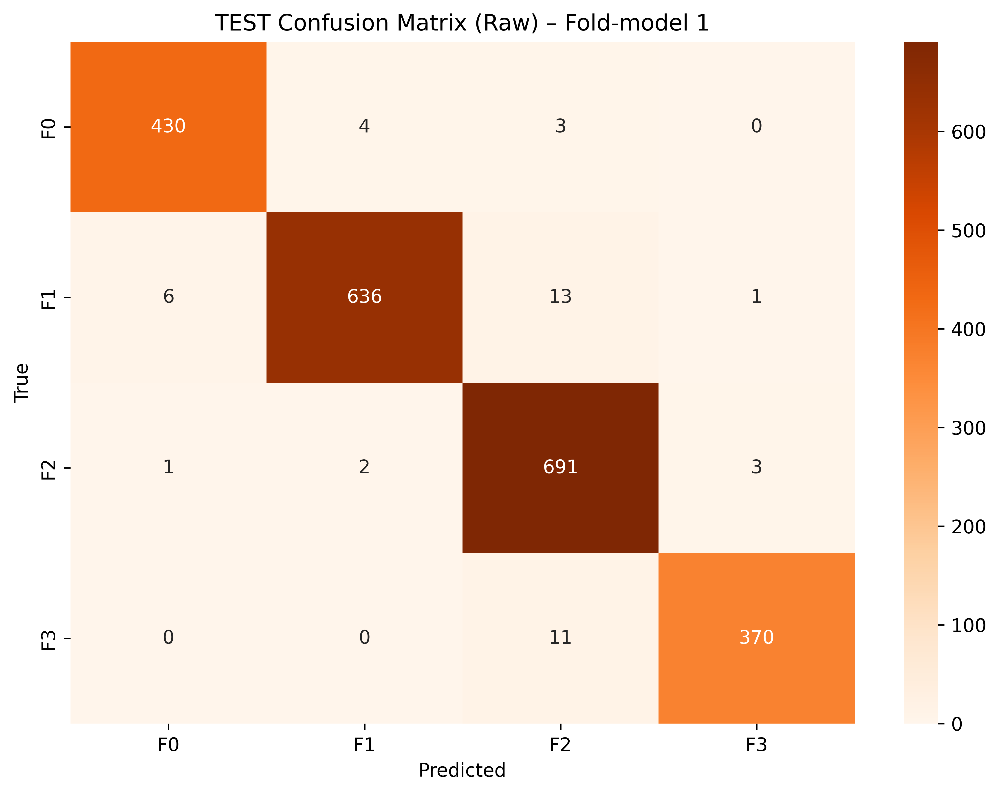

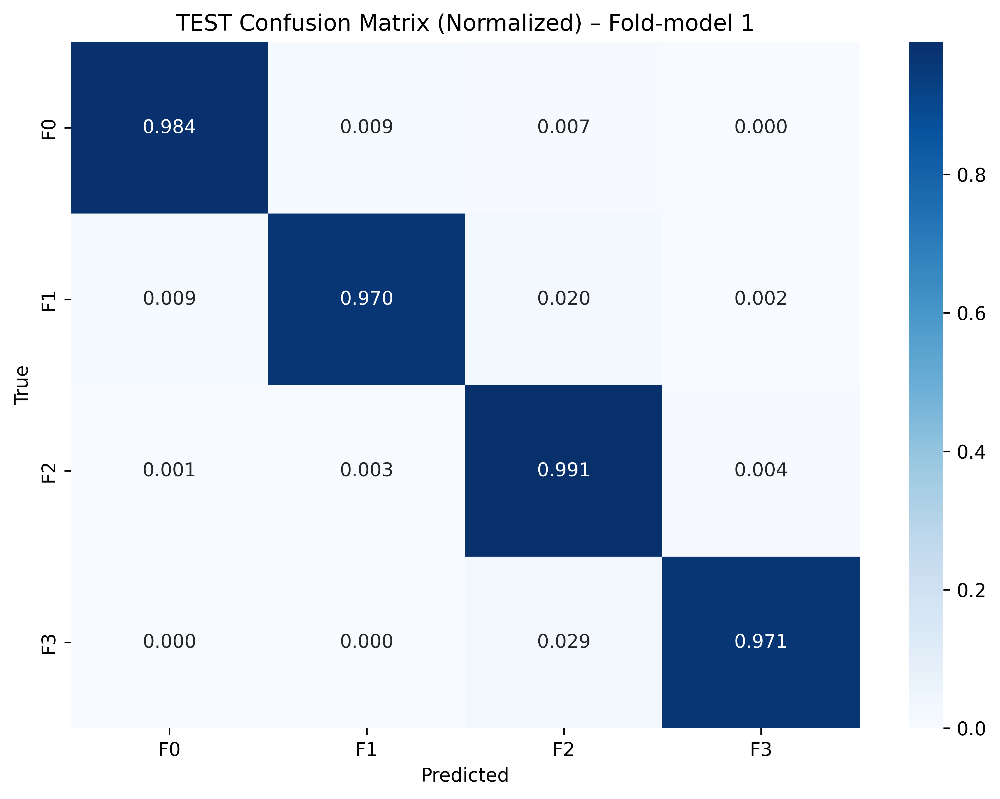


📄 Classification Report (Fold-model 1 on TEST):
              precision    recall  f1-score   support

          F0     0.9840    0.9840    0.9840       437
          F1     0.9907    0.9695    0.9800       656
          F2     0.9624    0.9914    0.9767       697
          F3     0.9893    0.9711    0.9801       381

    accuracy                         0.9797      2171
   macro avg     0.9816    0.9790    0.9802      2171
weighted avg     0.9800    0.9797    0.9797      2171


🔹 Fold-model 2 on TEST set...
✅ Fold 2 TEST Accuracy: 0.9737
✅ Fold 2 TEST QWK:      0.9753


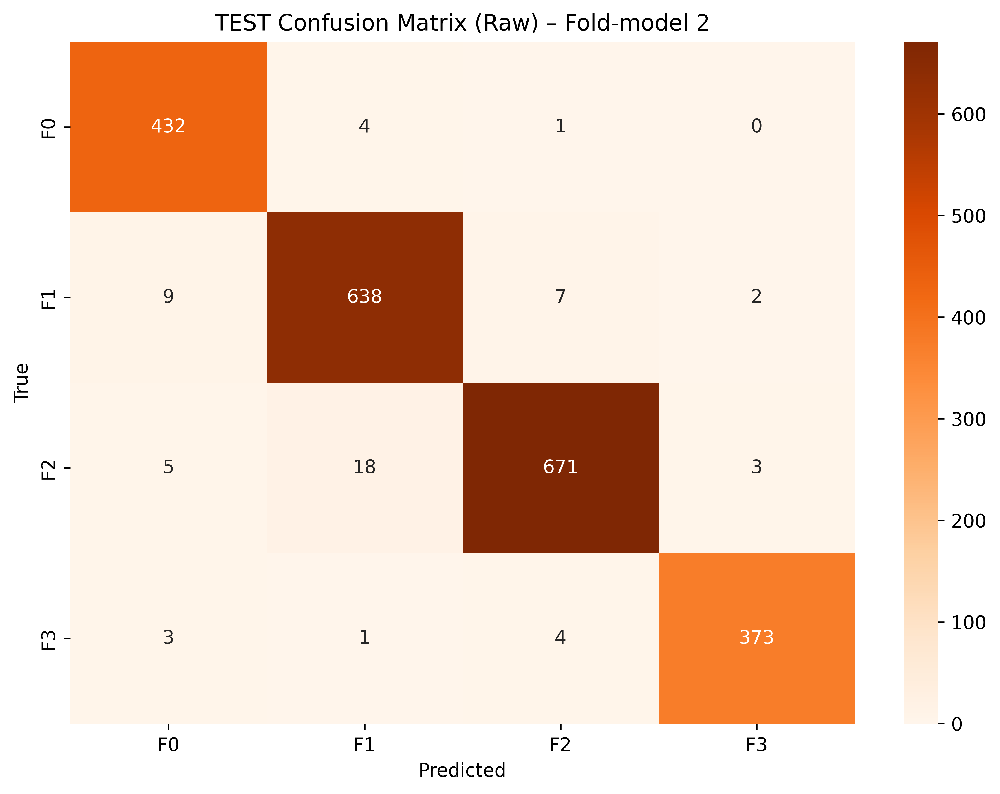

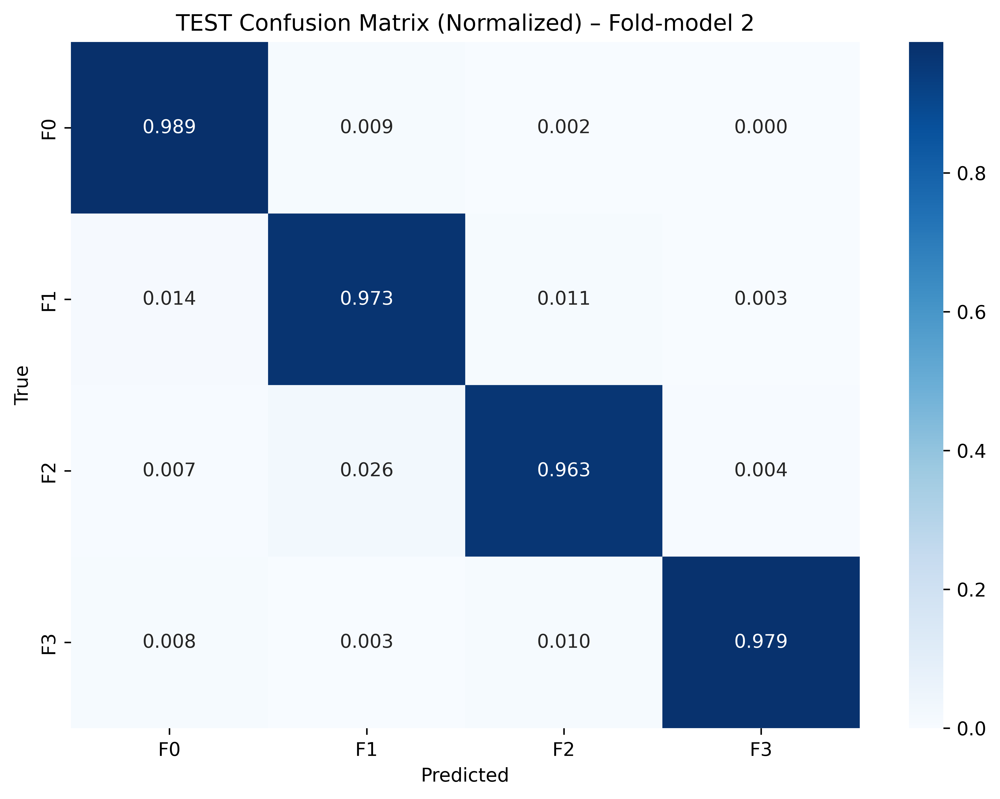


📄 Classification Report (Fold-model 2 on TEST):
              precision    recall  f1-score   support

          F0     0.9621    0.9886    0.9752       437
          F1     0.9652    0.9726    0.9689       656
          F2     0.9824    0.9627    0.9725       697
          F3     0.9868    0.9790    0.9829       381

    accuracy                         0.9737      2171
   macro avg     0.9741    0.9757    0.9748      2171
weighted avg     0.9739    0.9737    0.9737      2171


🔹 Fold-model 3 on TEST set...
✅ Fold 3 TEST Accuracy: 0.9613
✅ Fold 3 TEST QWK:      0.9701


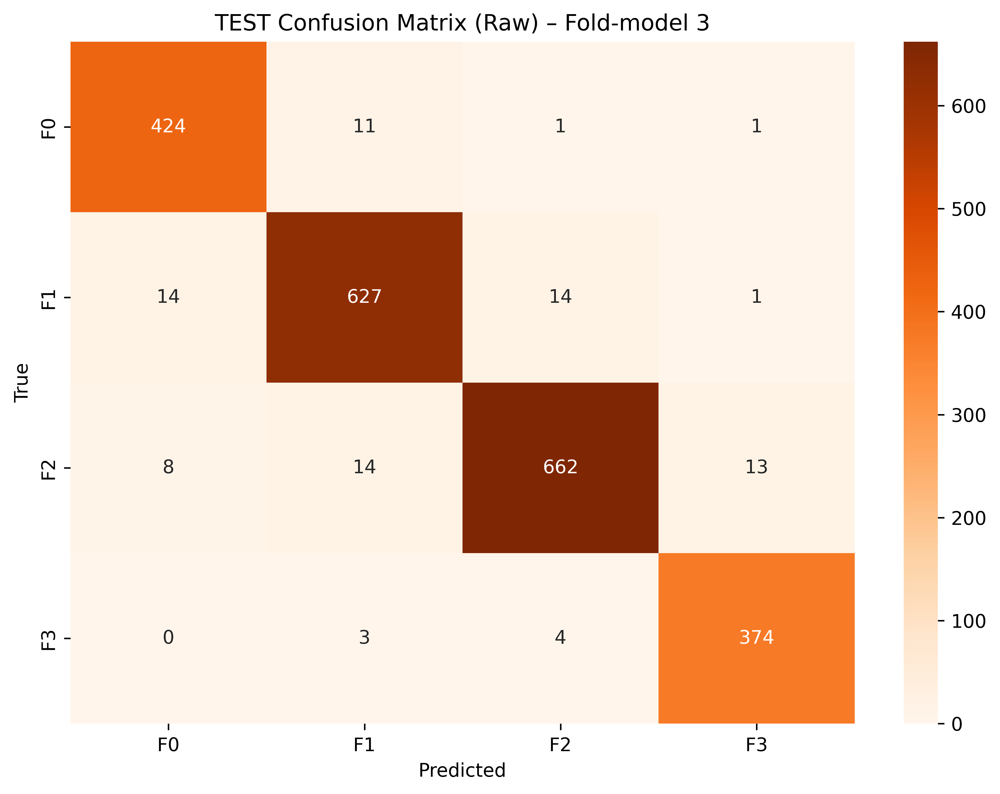

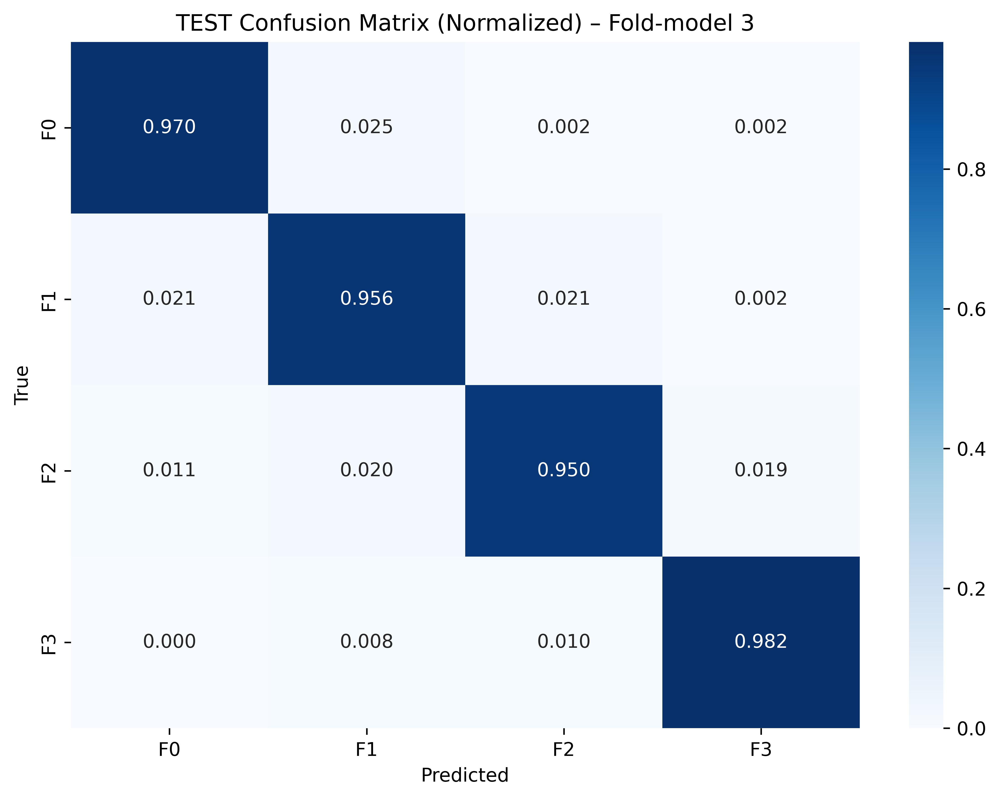


📄 Classification Report (Fold-model 3 on TEST):
              precision    recall  f1-score   support

          F0     0.9507    0.9703    0.9604       437
          F1     0.9573    0.9558    0.9565       656
          F2     0.9721    0.9498    0.9608       697
          F3     0.9614    0.9816    0.9714       381

    accuracy                         0.9613      2171
   macro avg     0.9604    0.9644    0.9623      2171
weighted avg     0.9614    0.9613    0.9613      2171


📊 OVERALL (Aggregated) TEST PERFORMANCE
⚠️ Note: This is NOT an ensemble. Test set is repeated across folds.
✅ Overall Accuracy: 0.9716
✅ Overall QWK:      0.9772


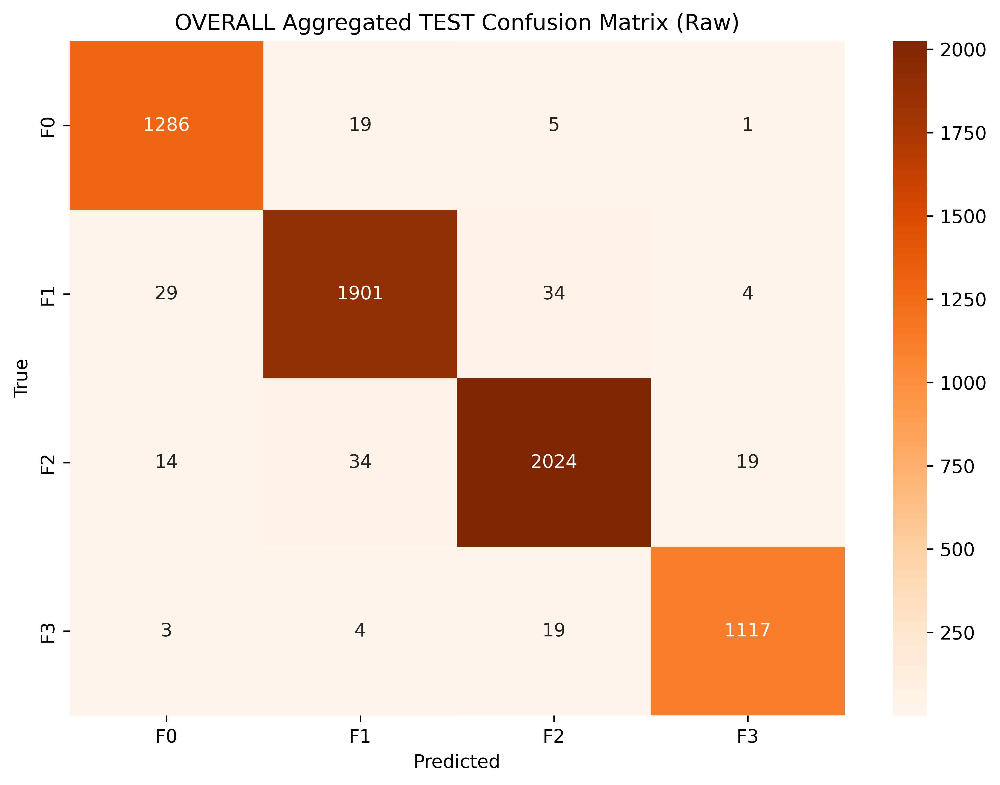

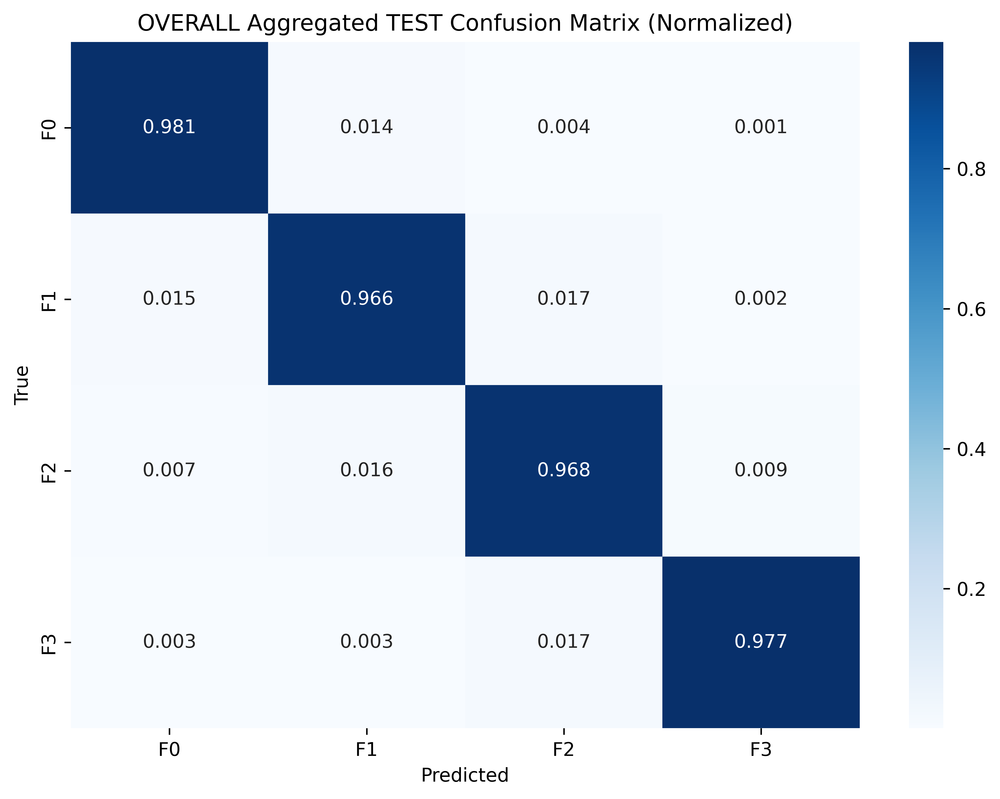


📄 Classification Report (OVERALL aggregated TEST):
              precision    recall  f1-score   support

          F0     0.9655    0.9809    0.9731      1311
          F1     0.9709    0.9660    0.9684      1968
          F2     0.9721    0.9680    0.9700      2091
          F3     0.9790    0.9773    0.9781      1143

    accuracy                         0.9716      6513
   macro avg     0.9719    0.9730    0.9724      6513
weighted avg     0.9716    0.9716    0.9716      6513



In [10]:
# ============================
# 1) SGN + DenseNet (MRI): TEST SET RESULTS PER FOLD MODEL + OVERALL (600 DPI)
# (Fold-model-on-test; NOT CV validation)
# ============================

import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch.utils.data import DataLoader
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, cohen_kappa_score

print("\n📌 SGN + DenseNet (MRI): PER-FOLD (fold-model-on-test) + OVERALL (600 DPI)")

# ---- safety ----
if "test_df" not in globals():
    raise NameError("❌ test_df is not defined. Create held-out test_df first.")
if "DenseNetGridSGN" not in globals():
    raise NameError("❌ DenseNetGridSGN not found. Run the model definition cell first.")

# class names
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# test loader
test_loader = DataLoader(
    LiverDataset(test_df, transform=valid_tfms),
    batch_size=CFG.BATCH_SIZE,
    shuffle=False,
    num_workers=2
)

# fold weight files
fold_models = [f"sgn_fold{i+1}.pth" for i in range(CFG.N_SPLITS)]

all_true, all_pred = [], []

def load_sgn_model(path):
    m = DenseNetGridSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    m.load_state_dict(torch.load(path, map_location=CFG.DEVICE))
    m.eval()
    return m

for fold, model_path in enumerate(fold_models, start=1):
    if not os.path.exists(model_path):
        print(f"\n⚠️ Skipping Fold-model {fold} (missing): {model_path}")
        continue

    print(f"\n🔹 Fold-model {fold} on TEST set...")
    model = load_sgn_model(model_path)

    y_true_fold, y_pred_fold = [], []

    with torch.no_grad():
        for imgs, labels in test_loader:
            imgs = imgs.to(CFG.DEVICE)
            out = model(imgs)
            preds = out.argmax(dim=1).cpu().numpy()

            y_pred_fold.extend(preds)
            y_true_fold.extend(labels.numpy())

    fold_acc = accuracy_score(y_true_fold, y_pred_fold)
    fold_qwk = cohen_kappa_score(y_true_fold, y_pred_fold, weights="quadratic")

    print(f"✅ Fold {fold} TEST Accuracy: {fold_acc:.4f}")
    print(f"✅ Fold {fold} TEST QWK:      {fold_qwk:.4f}")

    # aggregate (note: test set repeated across folds → aggregated is NOT ensemble)
    all_true.extend(y_true_fold)
    all_pred.extend(y_pred_fold)

    # confusion matrix
    cm_raw = confusion_matrix(y_true_fold, y_pred_fold)

    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_raw, annot=True, fmt="d", cmap="Oranges",
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f"TEST Confusion Matrix (Raw) – Fold-model {fold}")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    cm_norm = cm_raw.astype(float) / (cm_raw.sum(axis=1, keepdims=True) + 1e-8)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_norm, annot=True, fmt=".3f", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f"TEST Confusion Matrix (Normalized) – Fold-model {fold}")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    print(f"\n📄 Classification Report (Fold-model {fold} on TEST):")
    print(classification_report(y_true_fold, y_pred_fold, target_names=class_names, digits=4, zero_division=0))

# ---- aggregated overall (NOT ensemble) ----
all_true = np.array(all_true)
all_pred = np.array(all_pred)

if len(all_true) == 0:
    print("\n❌ No predictions collected. Check weight paths and test_loader.")
else:
    overall_acc = accuracy_score(all_true, all_pred)
    overall_qwk = cohen_kappa_score(all_true, all_pred, weights="quadratic")

    print("\n========================================")
    print("📊 OVERALL (Aggregated) TEST PERFORMANCE")
    print("⚠️ Note: This is NOT an ensemble. Test set is repeated across folds.")
    print(f"✅ Overall Accuracy: {overall_acc:.4f}")
    print(f"✅ Overall QWK:      {overall_qwk:.4f}")
    print("========================================")

    cm_overall = confusion_matrix(all_true, all_pred)

    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_overall, annot=True, fmt="d", cmap="Oranges",
                xticklabels=class_names, yticklabels=class_names)
    plt.title("OVERALL Aggregated TEST Confusion Matrix (Raw)")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    cm_overall_norm = cm_overall.astype(float) / (cm_overall.sum(axis=1, keepdims=True) + 1e-8)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_overall_norm, annot=True, fmt=".3f", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.title("OVERALL Aggregated TEST Confusion Matrix (Normalized)")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    print("\n📄 Classification Report (OVERALL aggregated TEST):")
    print(classification_report(all_true, all_pred, target_names=class_names, digits=4, zero_division=0))



🚀 Evaluating MAIN TEST SET (Ensemble) — DenseNet + SGN (MRI)...

📊 MAIN TEST SET RESULTS (ENSEMBLE) — DenseNet + SGN (MRI)
✅ Test Accuracy: 0.9926
✅ Test QWK:      0.9950

📄 Classification Report:
              precision    recall  f1-score   support

          F0     0.9887    1.0000    0.9943       437
          F1     0.9954    0.9909    0.9931       656
          F2     0.9928    0.9885    0.9907       697
          F3     0.9921    0.9948    0.9934       381

    accuracy                         0.9926      2171
   macro avg     0.9923    0.9935    0.9929      2171
weighted avg     0.9926    0.9926    0.9926      2171



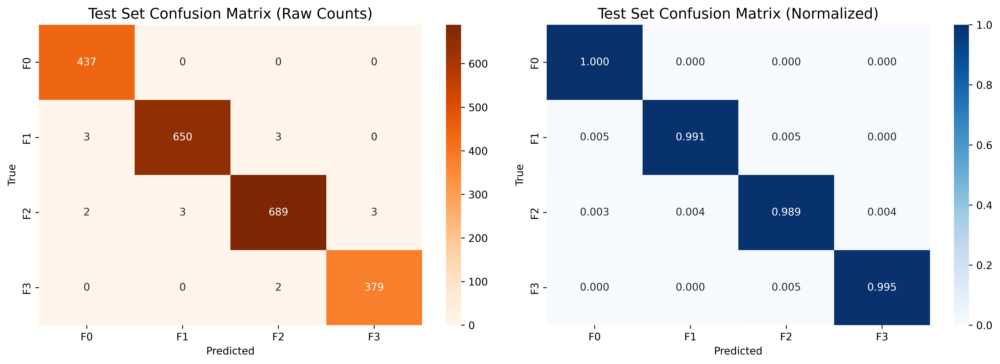


✅ Saved: test_confusion_matrix_ensemble_sgn_mri.png
✅ all_probs saved for ROC/AUC cell.


In [11]:
# ============================
# 2) TEST SET EVALUATION (ENSEMBLE) — MAIN RESULT (SGN + DenseNet MRI) (600 DPI)
# ============================

import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch.utils.data import DataLoader
from sklearn.metrics import accuracy_score, cohen_kappa_score, confusion_matrix, classification_report

print("\n🚀 Evaluating MAIN TEST SET (Ensemble) — DenseNet + SGN (MRI)...")

# safety
if "test_df" not in globals():
    raise NameError("❌ test_df not defined.")
if "DenseNetGridSGN" not in globals():
    raise NameError("❌ DenseNetGridSGN not defined.")

test_loader = DataLoader(
    LiverDataset(test_df, transform=valid_tfms),
    batch_size=CFG.BATCH_SIZE,
    shuffle=False,
    num_workers=2
)

fold_models = [f"sgn_fold{i+1}.pth" for i in range(CFG.N_SPLITS)]

# load models
models = []
for p in fold_models:
    if not os.path.exists(p):
        print(f"⚠️ Missing weight file: {p}")
        continue
    m = DenseNetGridSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    m.load_state_dict(torch.load(p, map_location=CFG.DEVICE))
    m.eval()
    models.append(m)

if len(models) == 0:
    raise FileNotFoundError("❌ No fold models loaded. Check sgn_fold*.pth exist.")

class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# inference (store probs for ROC)
all_labels, all_preds, all_probs = [], [], []

with torch.no_grad():
    for imgs, labels in test_loader:
        imgs = imgs.to(CFG.DEVICE)

        probs = torch.zeros((imgs.size(0), CFG.NUM_CLASSES), device=CFG.DEVICE)
        for m in models:
            probs += torch.softmax(m(imgs), dim=1)
        probs /= len(models)

        preds = torch.argmax(probs, dim=1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.numpy())
        all_probs.extend(probs.cpu().numpy())

all_labels = np.array(all_labels)
all_preds  = np.array(all_preds)
all_probs  = np.array(all_probs)

acc = accuracy_score(all_labels, all_preds)
qwk = cohen_kappa_score(all_labels, all_preds, weights="quadratic")

print("\n========================================")
print("📊 MAIN TEST SET RESULTS (ENSEMBLE) — DenseNet + SGN (MRI)")
print(f"✅ Test Accuracy: {acc:.4f}")
print(f"✅ Test QWK:      {qwk:.4f}")
print("========================================")

print("\n📄 Classification Report:")
print(classification_report(all_labels, all_preds, target_names=class_names, digits=4, zero_division=0))

cm = confusion_matrix(all_labels, all_preds)

fig, ax = plt.subplots(1, 2, figsize=(14, 5), dpi=600)

sns.heatmap(cm, annot=True, fmt="d", cmap="Oranges",
            xticklabels=class_names, yticklabels=class_names, ax=ax[0])
ax[0].set_title("Test Set Confusion Matrix (Raw Counts)", fontsize=14)
ax[0].set_xlabel("Predicted"); ax[0].set_ylabel("True")

cm_norm = cm.astype(float) / (cm.sum(axis=1, keepdims=True) + 1e-8)
sns.heatmap(cm_norm, annot=True, fmt=".3f", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names, ax=ax[1])
ax[1].set_title("Test Set Confusion Matrix (Normalized)", fontsize=14)
ax[1].set_xlabel("Predicted"); ax[1].set_ylabel("True")

plt.tight_layout()
plt.show()

fig.savefig("test_confusion_matrix_ensemble_sgn_mri.png", dpi=600, bbox_inches="tight")
print("\n✅ Saved: test_confusion_matrix_ensemble_sgn_mri.png")
print("✅ all_probs saved for ROC/AUC cell.")


🚀 Generating ROC/AUC Curves (MRI)...

📊 ROC/AUC RESULTS (TEST SET) — DenseNet + SGN (MRI)
✅ Micro-average AUC: 0.9999
✅ Macro-average AUC: 0.9999
   - F0 AUC: 1.0000
   - F1 AUC: 0.9998
   - F2 AUC: 0.9998
   - F3 AUC: 0.9999


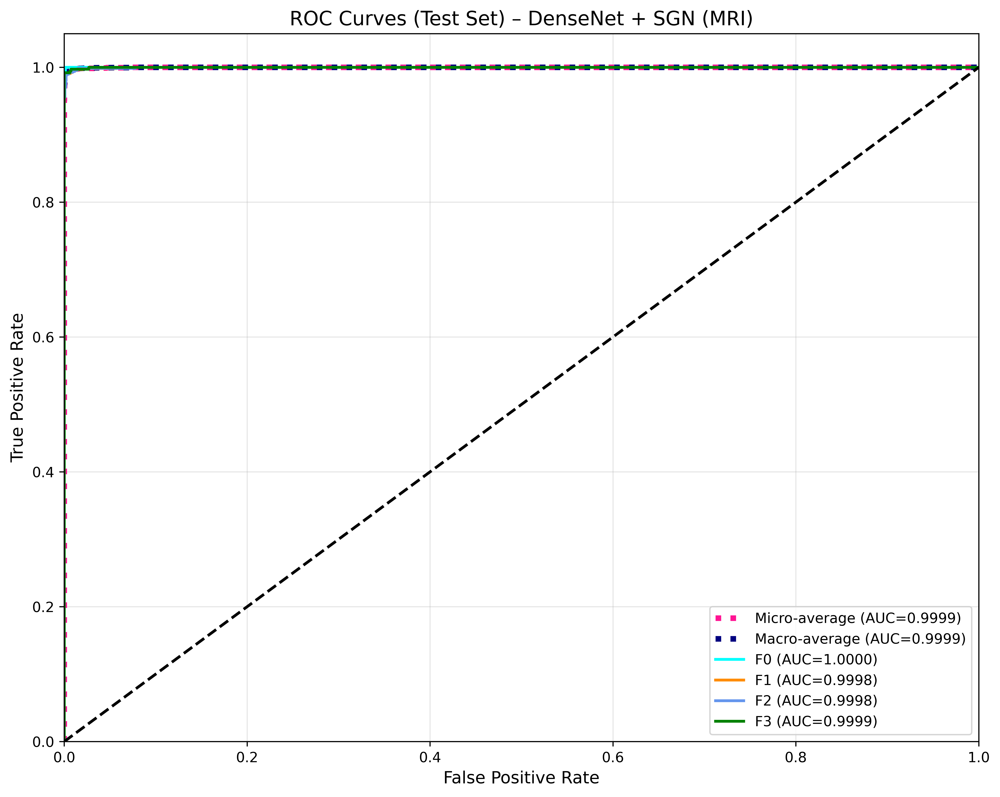

✅ Saved: roc_auc_densenet_sgn_mri_test.png


In [12]:
# ============================
# 3) ROC/AUC CURVES (SGN + DenseNet MRI) — 600 DPI
# ============================
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from itertools import cycle
import numpy as np
import matplotlib.pyplot as plt

print("🚀 Generating ROC/AUC Curves (MRI)...")

if "all_probs" not in globals() or "all_labels" not in globals():
    raise NameError("❌ Run the ENSEMBLE TEST evaluation cell first to create all_probs and all_labels.")

y_test  = label_binarize(all_labels, classes=range(CFG.NUM_CLASSES))
y_score = all_probs
n_classes = y_test.shape[1]

fpr, tpr, roc_auc = {}, {}, {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# micro
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# macro
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

print("\n========================================")
print("📊 ROC/AUC RESULTS (TEST SET) — DenseNet + SGN (MRI)")
print(f"✅ Micro-average AUC: {roc_auc['micro']:.4f}")
print(f"✅ Macro-average AUC: {roc_auc['macro']:.4f}")
for i in range(n_classes):
    print(f"   - {class_names[i]} AUC: {roc_auc[i]:.4f}")
print("========================================")

fig = plt.figure(figsize=(10, 8), dpi=600)

plt.plot(fpr["micro"], tpr["micro"],
         label=f"Micro-average (AUC={roc_auc['micro']:.4f})",
         color="deeppink", linestyle=":", lw=4)

plt.plot(fpr["macro"], tpr["macro"],
         label=f"Macro-average (AUC={roc_auc['macro']:.4f})",
         color="navy", linestyle=":", lw=4)

colors = cycle(["aqua", "darkorange", "cornflowerblue", "green"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f"{class_names[i]} (AUC={roc_auc[i]:.4f})")

plt.plot([0, 1], [0, 1], "k--", lw=2)
plt.xlim([0.0, 1.0]); plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate", fontsize=12)
plt.ylabel("True Positive Rate", fontsize=12)
plt.title("ROC Curves (Test Set) – DenseNet + SGN (MRI)", fontsize=14)
plt.legend(loc="lower right", fontsize=10)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

fig.savefig("roc_auc_densenet_sgn_mri_test.png", dpi=600, bbox_inches="tight")
print("✅ Saved: roc_auc_densenet_sgn_mri_test.png")


In [35]:
# ======================================================
# Option C: 4 random images PER CLASS (recommended)
# ======================================================
def predict_interface_k_per_class(df_data, k=4, dpi=300, seed=42):
    np.random.seed(seed)

    # class names
    class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

    # collect samples: k per class
    rows = []
    for c in range(CFG.NUM_CLASSES):
        sub = df_data[df_data["diagnosis"] == c]
        if len(sub) == 0:
            print(f"⚠️ No samples for class {class_names[c]} in this df, skipping.")
            continue

        take = min(k, len(sub))
        sampled = sub.sample(take, random_state=np.random.randint(0, 100000))
        rows.extend(sampled.to_dict("records"))

    if len(rows) == 0:
        print("❌ No samples collected.")
        return

    # grid size
    n = len(rows)
    ncols = k
    nrows = int(np.ceil(n / ncols))

    print(f"\n🔍 Testing {k} random images per class → total {n} images ({nrows}×{ncols})")

    fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 4.8*nrows), dpi=dpi)
    axes = np.array(axes).reshape(nrows, ncols)

    idx = 0
    for r in range(nrows):
        for ccol in range(ncols):
            ax = axes[r, ccol]
            if idx >= n:
                ax.axis("off")
                continue

            row = rows[idx]
            idx += 1

            img = cv2.imread(row["image_path"])
            if img is None:
                ax.axis("off")
                continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

            t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

            with torch.no_grad():
                p = ensemble_sgn(t)[0].cpu().numpy()

            pred = int(np.argmax(p))
            conf = float(p[pred] * 100.0)
            true = int(row["diagnosis"])

            col = "green" if pred == true else "red"
            ax.imshow(img)
            ax.set_title(
                f"True: {class_names[true]} | Pred: {class_names[pred]}\nConf: {conf:.1f}%",
                color=col, fontweight="bold"
            )
            ax.axis("off")

    plt.tight_layout()
    plt.show()


# ✅ Run: 4 random images per class
predict_interface_k_per_class(test_df, k=4, dpi=600, seed=42)



🔍 Testing 4 random images per class → total 16 images (4×4)


In [34]:
def predict_interface_k_per_class(df_data, k=5, seed=42, dpi=600):
    rng = np.random.RandomState(seed)
    rows = []
    for c in range(CFG.NUM_CLASSES):
        sub = df_data[df_data["diagnosis"] == c]
        take = min(k, len(sub))
        rows.extend(list(sub.sample(take, random_state=rng.randint(0,1_000_000)).itertuples()))
    n = len(rows)
    fig, axes = plt.subplots((n+4)//5, 5, figsize=(20, 4*((n+4)//5)), dpi=dpi)
    axes = axes.flatten()

    for i, row in enumerate(rows):
        img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))
        t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)
        with torch.no_grad():
            p = ensemble_sgn(t)[0].cpu().numpy()
        pred = int(np.argmax(p)); true = int(row.diagnosis)
        conf = p[pred]*100
        col = "green" if pred == true else "red"
        axes[i].imshow(img)
        axes[i].set_title(f"True F{true} | Pred F{pred}\n{conf:.1f}%", color=col, fontweight="bold")
        axes[i].axis("off")

    for j in range(i+1, len(axes)):
        axes[j].axis("off")
    plt.tight_layout()
    plt.show()

predict_interface_k_per_class(test_df, k=5, seed=42)


🚀 Generating 6-Panel XAI for DenseNet121 + SGN (MRI)...

--- True: F0 | Pred: F1 (50.4%) ---


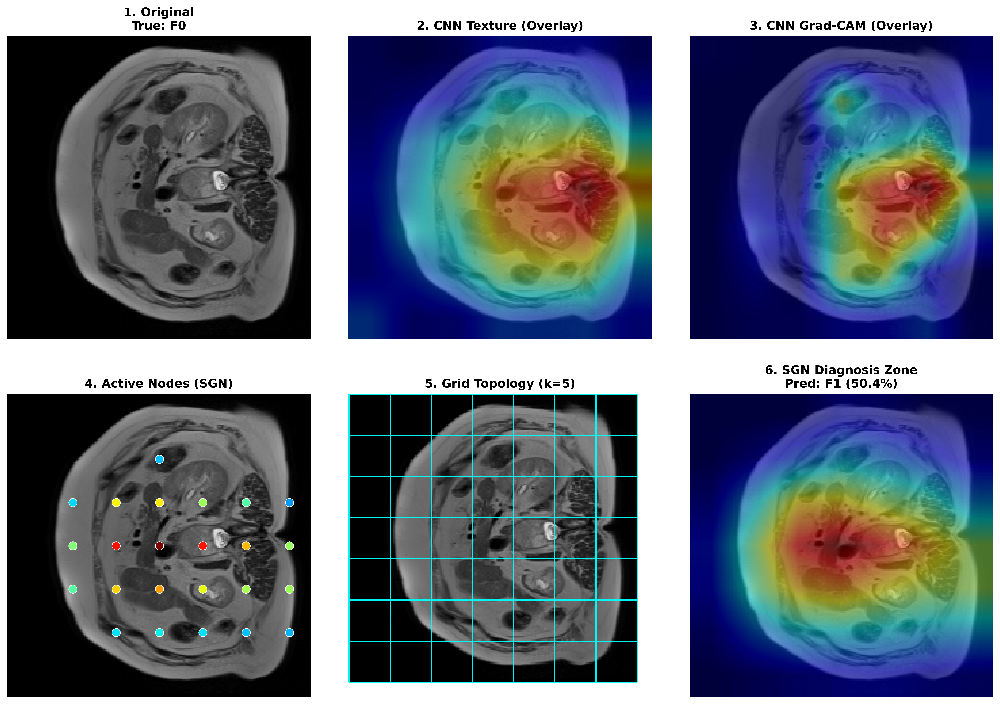


--- True: F1 | Pred: F1 (76.1%) ---


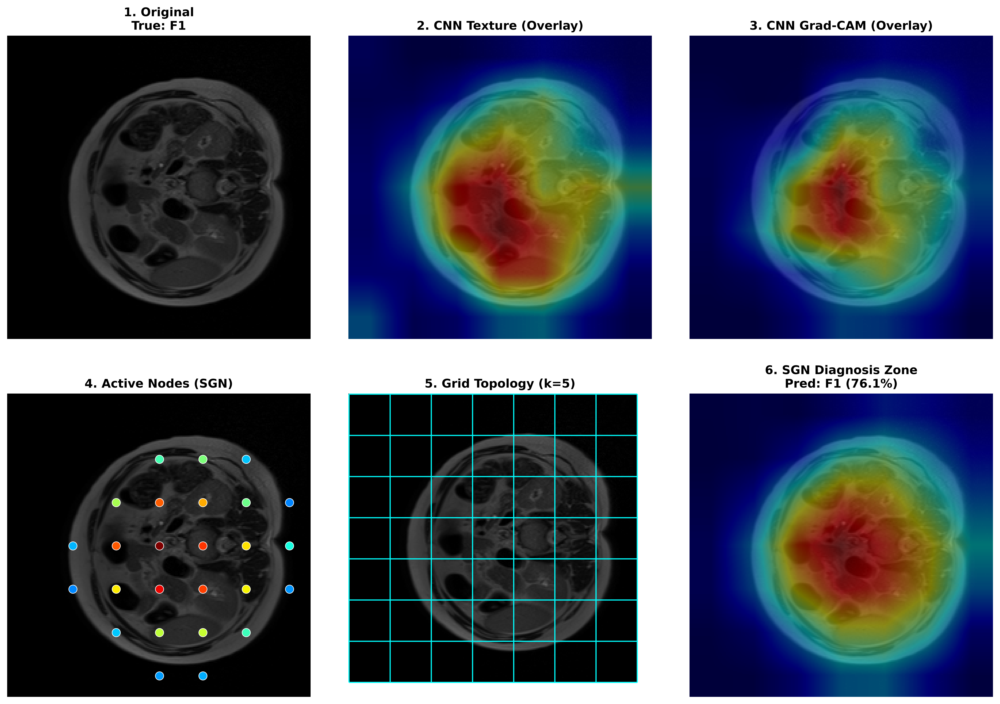


--- True: F2 | Pred: F2 (82.6%) ---


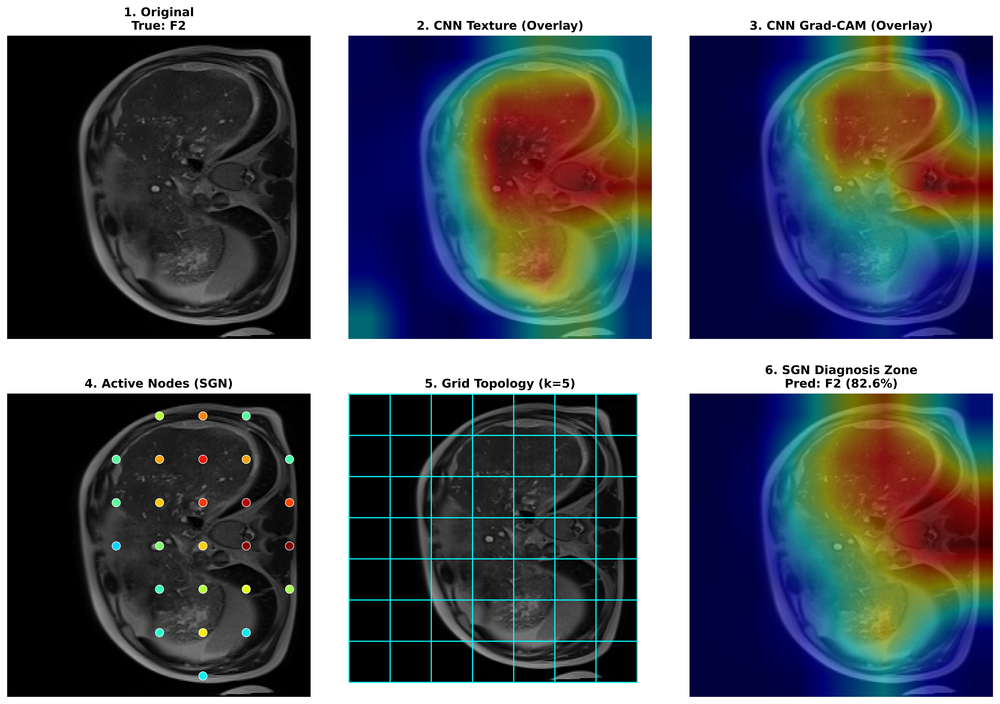


--- True: F3 | Pred: F3 (96.7%) ---


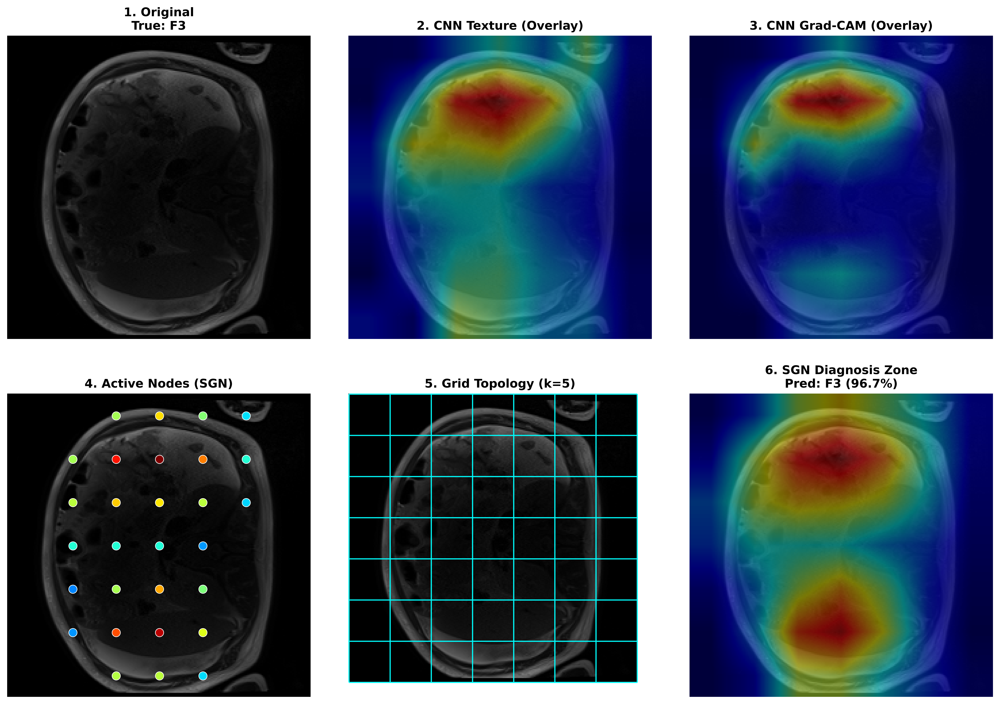

In [33]:
# ============================
# 5) 6-PANEL XAI VISUALIZATION (DenseNet + SGN MRI) — FULL UPDATED (GRID FIX)
# - Texture: CNN feature energy
# - Attention: Grad-CAM on CNN feature map
# - Graph Attention: SGN get_graph_activations (node importance)
# - Panel 5: TRUE GRID LINES (CLEAR + VISIBLE)
# ============================

import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F

print("🚀 Generating 6-Panel XAI for DenseNet121 + SGN (MRI)...")

# -------------------------------
# Pick dataframe safely
# -------------------------------
def pick_df_for_xai():
    if "test_df" in globals(): return test_df
    if "trainval_df" in globals(): return trainval_df
    if "train_val_df" in globals(): return train_val_df
    if "df" in globals(): return df
    raise NameError("❌ No dataframe found. Define one of: test_df / trainval_df / train_val_df / df")

df_use = pick_df_for_xai()

class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# -------------------------------
# Overlay helper
# -------------------------------
def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)  # BGR
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

# -------------------------------
# Build nodes + edges (optional; still used for panel 4)
# -------------------------------
def grid_nodes_edges(H, W):
    nodes = []
    edges = []
    for i in range(H * W):
        r, c = divmod(i, W)
        y = int((r + 0.5) * (CFG.IMG_SIZE / H))
        x = int((c + 0.5) * (CFG.IMG_SIZE / W))
        nodes.append((x, y))
        if c + 1 < W: edges.append((i, i + 1))
        if r + 1 < H: edges.append((i, i + W))
    return nodes, edges

# -------------------------------
# XAI extraction:
# - hooks DenseNet feature maps correctly (timm DenseNet -> model.cnn.features)
# - grad-cam on cnn feature map
# - SGN graph activations from model.get_graph_activations()
# -------------------------------
def extract_sgn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))

    if not hasattr(model, "cnn"):
        raise AttributeError("❌ model.cnn not found. Your class must have self.cnn (timm model).")

    # ✅ Correct hook target for timm DenseNet
    hook_target = model.cnn.features if hasattr(model.cnn, "features") else model.cnn
    h = hook_target.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred   = logits.argmax(1).item()
        conf   = probs[0, pred].item()

        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    if len(fmaps) == 0 or len(grads) == 0:
        raise RuntimeError(
            "❌ Hook did not capture feature maps/gradients.\n"
            "This should work for timm DenseNet121: model.cnn.features.\n"
            "If it fails, print(model) and hook a deeper layer explicitly."
        )

    fmap = fmaps[0].detach()  # [B,C,H,W]
    grad = grads[0].detach()

    B, C, Hf, Wf = fmap.shape

    # Texture map (mean feature energy)
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = (tex - tex.min()) / (tex.max() - tex.min() + 1e-8)

    # Grad-CAM on CNN feature map
    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

    # SGN graph activations (node importance)
    with torch.no_grad():
        gact = model.get_graph_activations(img_tensor).squeeze().cpu().numpy()  # [Hf,Wf]
        gact = (gact - gact.min()) / (gact.max() - gact.min() + 1e-8)

    nodes, edges = grid_nodes_edges(Hf, Wf)
    return tex, cam, gact, nodes, edges, pred, conf, Hf, Wf

# -------------------------------
# Plot 6-panel (Panel 5 GRID FIX)
# -------------------------------
def plot_sgn_6_panel(img, tex, cam, gact, nodes, edges, true_y, pred_y, conf, Hf, Wf, dpi=300):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)

    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    tex_rs  = cv2.resize(tex,  sz)
    cam_rs  = cv2.resize(cam,  sz)
    gact_rs = cv2.resize(gact, sz)

    tex_overlay  = overlay_heatmap_on_image(img, tex_rs,  alpha=0.45)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs,  alpha=0.45)
    gact_overlay = overlay_heatmap_on_image(img, gact_rs, alpha=0.45)

    font = {'weight': 'bold', 'size': 12}

    # 1) Original
    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {class_names[true_y]}", font)

    # 2) CNN Texture
    ax[0,1].imshow(tex_overlay)
    ax[0,1].set_title("2. CNN Texture (Overlay)", font)

    # 3) CNN Grad-CAM
    ax[0,2].imshow(cam_overlay)
    ax[0,2].set_title("3. CNN Grad-CAM (Overlay)", font)

    # 4) Active Nodes (SGN) - show node centers with high gact
    ax[1,0].imshow(img)
    flat = gact.flatten()
    for i, (nx, ny) in enumerate(nodes):
        if i < len(flat) and flat[i] > 0.25:
            ax[1,0].scatter(nx, ny, c=[plt.cm.jet(flat[i])], s=70,
                            edgecolors='w', linewidths=0.6, zorder=2)
    ax[1,0].set_title("4. Active Nodes (SGN)", font)

    # 5) GRID TOPOLOGY (k=5) — FIXED (draw true grid lines clearly)
    ax[1,1].imshow(img, alpha=1.0)  # do NOT wash out image

    step_x = CFG.IMG_SIZE / Wf
    step_y = CFG.IMG_SIZE / Hf

    xs = np.arange(0, CFG.IMG_SIZE + 1e-6, step_x)
    ys = np.arange(0, CFG.IMG_SIZE + 1e-6, step_y)

    # clear visible lines
    ax[1,1].vlines(xs, 0, CFG.IMG_SIZE, colors="cyan", linewidth=1.2, alpha=0.95, zorder=10)
    ax[1,1].hlines(ys, 0, CFG.IMG_SIZE, colors="cyan", linewidth=1.2, alpha=0.95, zorder=10)

    ax[1,1].set_title("5. Grid Topology (k=5)", font)

    # 6) SGN Diagnosis Zone
    ax[1,2].imshow(gact_overlay)
    ax[1,2].set_title(f"6. SGN Diagnosis Zone\nPred: {class_names[pred_y]} ({conf*100:.1f}%)", font)

    for a in ax.flatten():
        a.axis("off")

    plt.show()

# -------------------------------
# Load model (fold1) for XAI
# -------------------------------
weights_path = "sgn_fold1.pth"
if not os.path.exists(weights_path):
    raise FileNotFoundError(f"❌ Missing weights: {weights_path}")

model = DenseNetGridSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))
model.eval()

# -------------------------------
# Run random examples (1 per class)
# -------------------------------
np.random.seed(42)
for c in range(CFG.NUM_CLASSES):
    sub = df_use[df_use["diagnosis"] == c]
    if len(sub) == 0:
        print(f"⚠️ No samples for {class_names[c]}, skipping.")
        continue

    row = sub.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]
    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

    tex, cam, gact, nodes, edges, pred, conf, Hf, Wf = extract_sgn_xai(model, t, true_label=c)

    print(f"\n--- True: {class_names[c]} | Pred: {class_names[pred]} ({conf*100:.1f}%) ---")
    plot_sgn_6_panel(
        img, tex, cam, gact, nodes, edges,
        true_y=c, pred_y=pred, conf=conf, Hf=Hf, Wf=Wf, dpi=600
    )


🚀 Generating 6-Panel XAI for DenseNet121 + SGN (MRI)...

--- True: F0 | Pred: F1 (50.4%) ---


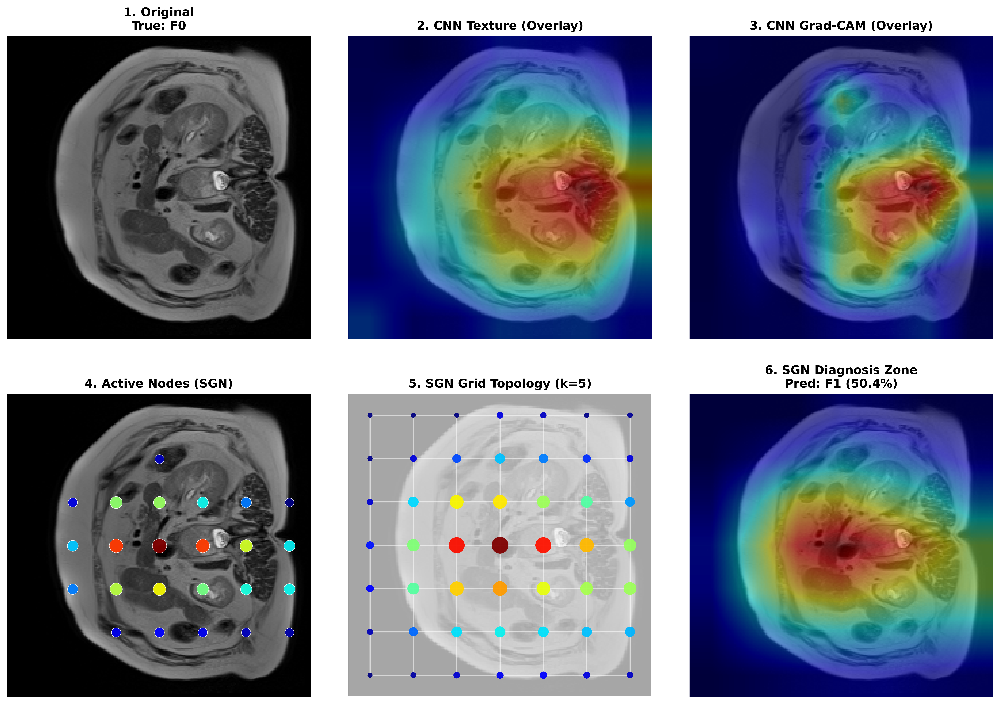


--- True: F1 | Pred: F1 (76.1%) ---


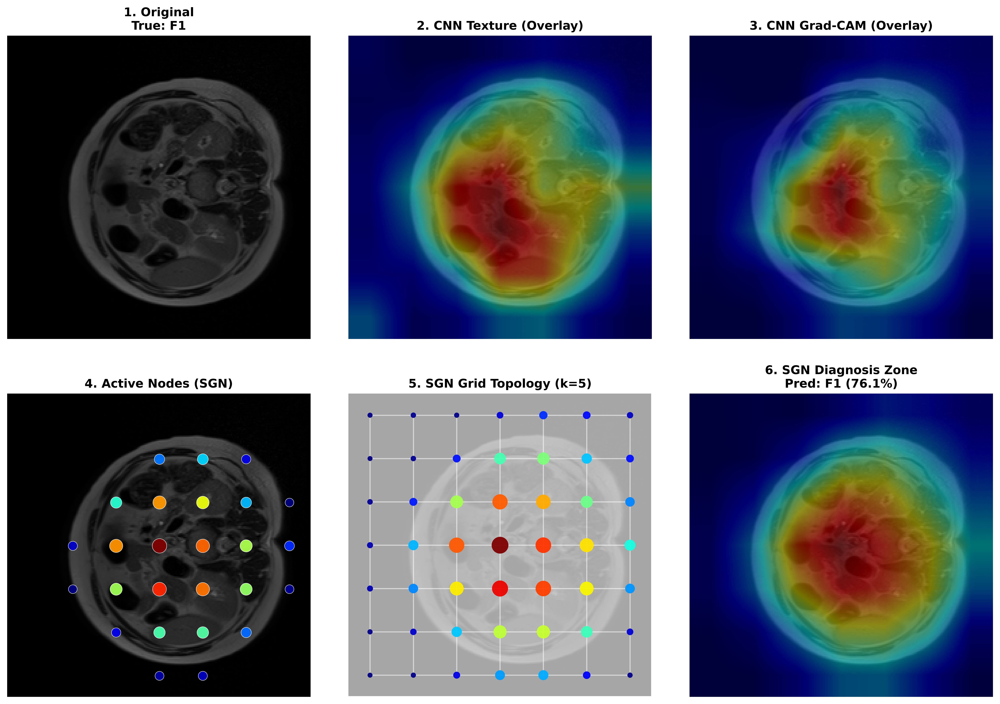


--- True: F2 | Pred: F2 (82.6%) ---


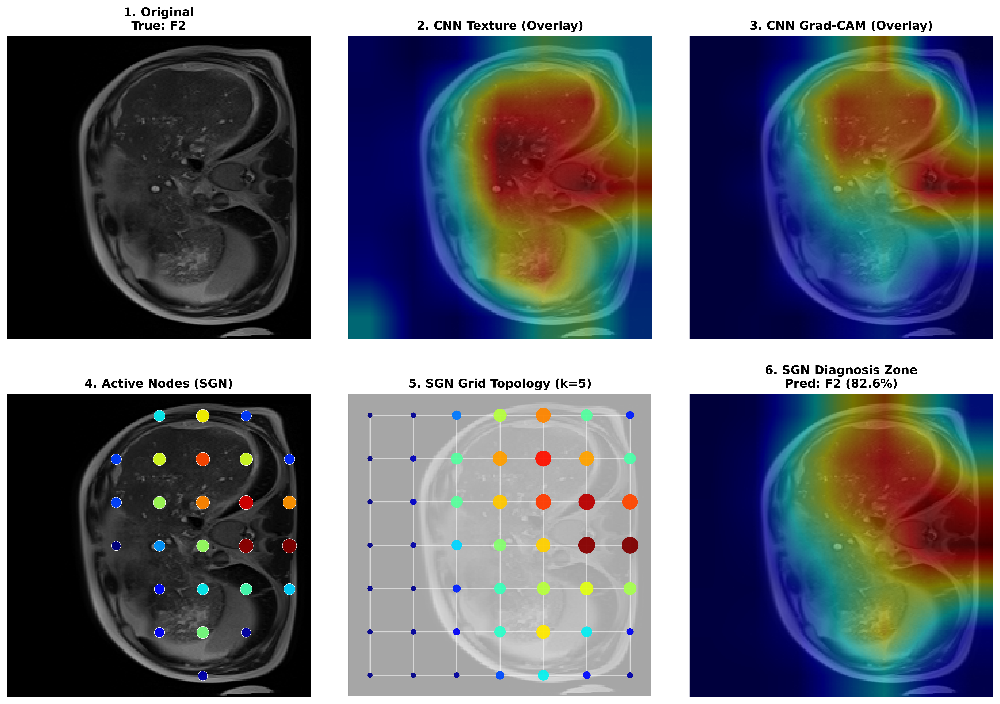


--- True: F3 | Pred: F3 (96.7%) ---


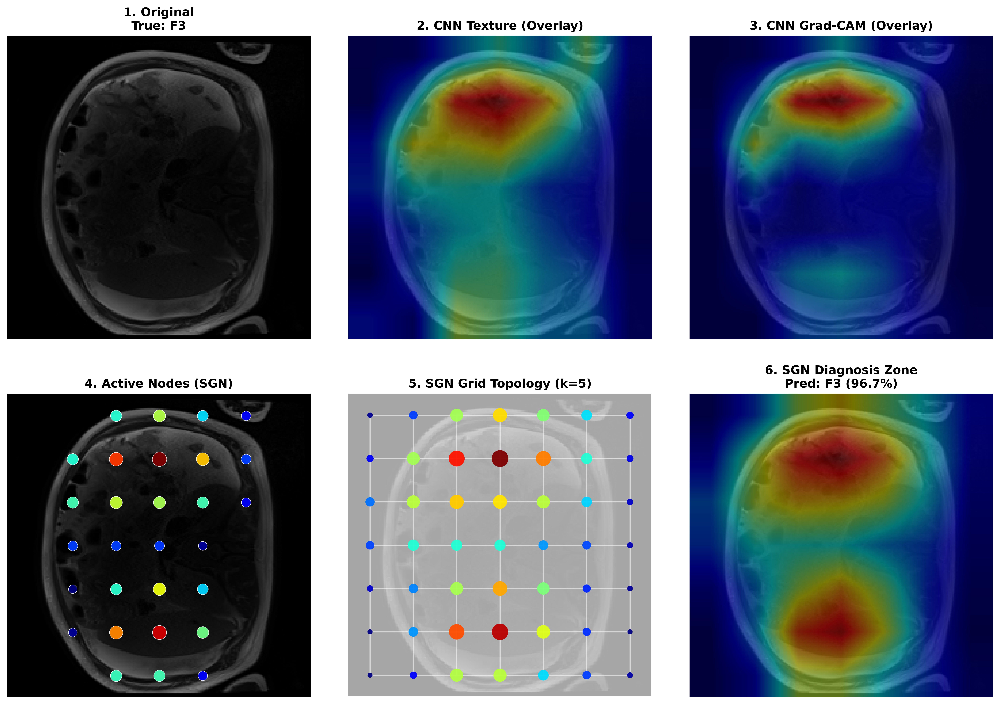

In [32]:
# ============================
# 5) 6-PANEL XAI VISUALIZATION (DenseNet + SGN MRI) — PANEL 5 LIKE YOUR PICTURE (FIXED)
# - Panel 5: Grid + colored nodes (size+color from SGN graph activations)
# ============================

import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
import networkx as nx

print("🚀 Generating 6-Panel XAI for DenseNet121 + SGN (MRI)...")

# -------------------------------
# Pick dataframe safely
# -------------------------------
def pick_df_for_xai():
    if "test_df" in globals(): return test_df
    if "trainval_df" in globals(): return trainval_df
    if "train_val_df" in globals(): return train_val_df
    if "df" in globals(): return df
    raise NameError("❌ No dataframe found. Define one of: test_df / trainval_df / train_val_df / df")

df_use = pick_df_for_xai()
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# -------------------------------
# Helpers
# -------------------------------
def norm01(x):
    x = np.asarray(x, dtype=np.float32)
    return (x - x.min()) / (x.max() - x.min() + 1e-8)

def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)  # BGR
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

def grid_node_positions(H, W, img_size=224):
    xs = (np.arange(W) + 0.5) * (img_size / W)
    ys = (np.arange(H) + 0.5) * (img_size / H)
    X, Y = np.meshgrid(xs, ys)            # [H,W]
    return X.flatten(), Y.flatten()       # [H*W], [H*W]

def build_grid_graph(H, W, node_weights_01, img_size=224):
    """
    Builds a 4-neighbor grid graph (right + down edges) with node positions on 224x224.
    node_weights_01: [H,W] normalized node importance in [0,1]
    """
    G = nx.Graph()
    for r in range(H):
        for c in range(W):
            nid = r * W + c

            # position centered per cell
            px = (c + 0.5) * (img_size / W)
            py = (r + 0.5) * (img_size / H)

            G.add_node(nid, pos=(px, py), weight=float(node_weights_01[r, c]))

            # edges: right & down (enough to show grid)
            if c + 1 < W:
                G.add_edge(nid, nid + 1)
            if r + 1 < H:
                G.add_edge(nid, nid + W)
    return G

# -------------------------------
# XAI extraction:
# - hook DenseNet feature maps from timm DenseNet -> model.cnn.features
# - grad-cam on cnn feature map
# - SGN graph activations from model.get_graph_activations()
# -------------------------------
def extract_sgn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))

    if not hasattr(model, "cnn"):
        raise AttributeError("❌ model.cnn not found. Your class must have self.cnn (timm model).")

    hook_target = model.cnn.features if hasattr(model.cnn, "features") else model.cnn
    h = hook_target.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred   = logits.argmax(1).item()
        conf   = probs[0, pred].item()

        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    if len(fmaps) == 0 or len(grads) == 0:
        raise RuntimeError(
            "❌ Hook did not capture feature maps/gradients.\n"
            "This should work for timm DenseNet121: model.cnn.features."
        )

    fmap = fmaps[0].detach()     # [B,C,H,W]
    grad = grads[0].detach()     # [B,C,H,W]
    B, C, Hf, Wf = fmap.shape

    # Texture map (mean feature energy)
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = norm01(tex)

    # Grad-CAM on CNN feature map
    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = norm01(cam)

    # SGN graph activations (node importance)
    with torch.no_grad():
        gact = model.get_graph_activations(img_tensor).squeeze().cpu().numpy()  # [Hf,Wf]
        gact = norm01(gact)

    return tex, cam, gact, pred, conf, Hf, Wf

# -------------------------------
# Plot 6-panel
# -------------------------------
def plot_sgn_6_panel(img, tex, cam, gact, true_y, pred_y, conf, Hf, Wf, dpi=300):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)

    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    tex_rs  = cv2.resize(tex,  sz)
    cam_rs  = cv2.resize(cam,  sz)
    gact_rs = cv2.resize(gact, sz)

    tex_overlay  = overlay_heatmap_on_image(img, tex_rs,  alpha=0.45)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs,  alpha=0.45)
    gact_overlay = overlay_heatmap_on_image(img, gact_rs, alpha=0.45)

    font = {'weight': 'bold', 'size': 12}

    # 1) Original
    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {class_names[true_y]}", font)

    # 2) CNN Texture
    ax[0,1].imshow(tex_overlay)
    ax[0,1].set_title("2. CNN Texture (Overlay)", font)

    # 3) CNN Grad-CAM
    ax[0,2].imshow(cam_overlay)
    ax[0,2].set_title("3. CNN Grad-CAM (Overlay)", font)

    # 4) Active nodes (SGN) - strong nodes
    ax[1,0].imshow(img)
    X, Y = grid_node_positions(Hf, Wf, img_size=CFG.IMG_SIZE)
    flat = gact.flatten()
    mask = flat > 0.25
    sizes = 30 + flat[mask] * 180
    ax[1,0].scatter(X[mask], Y[mask], c=flat[mask], s=sizes, cmap="jet",
                    alpha=0.95, edgecolors="white", linewidths=0.4, zorder=10)
    ax[1,0].set_title("4. Active Nodes (SGN)", font)

    # 5) Grid topology + colored nodes (LIKE YOUR PICTURE)
    ax[1,1].imshow(img, alpha=0.35)

    G = build_grid_graph(Hf, Wf, gact, img_size=CFG.IMG_SIZE)
    pos = nx.get_node_attributes(G, "pos")
    ws  = np.array([G.nodes[n]["weight"] for n in G.nodes], dtype=np.float32)

    # edges (grid lines)
    nx.draw_networkx_edges(G, pos, ax=ax[1,1], edge_color="white", alpha=0.55, width=1.1)

    # nodes (size+color)
    node_sizes = 25 + ws * 260
    nx.draw_networkx_nodes(
        G, pos, ax=ax[1,1],
        node_size=node_sizes,
        node_color=ws, cmap=plt.cm.jet,
        alpha=0.95,
        linewidths=0.0
    )

    ax[1,1].set_title("5. SGN Grid Topology (k=5)", fontsize=12, fontweight="bold")
    ax[1,1].set_ylim(CFG.IMG_SIZE, 0)
    ax[1,1].set_xlim(0, CFG.IMG_SIZE)

    # 6) Diagnosis zone overlay (gact)
    ax[1,2].imshow(gact_overlay)
    ax[1,2].set_title(f"6. SGN Diagnosis Zone\nPred: {class_names[pred_y]} ({conf*100:.1f}%)", font)

    for a in ax.flatten():
        a.axis("off")
    plt.show()

# -------------------------------
# Load model (fold1) for XAI
# -------------------------------
weights_path = "sgn_fold1.pth"
if not os.path.exists(weights_path):
    raise FileNotFoundError(f"❌ Missing weights: {weights_path}")

model = DenseNetGridSGN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))
model.eval()

# -------------------------------
# Run random examples (1 per class)
# -------------------------------
np.random.seed(42)
for c in range(CFG.NUM_CLASSES):
    sub = df_use[df_use["diagnosis"] == c]
    if len(sub) == 0:
        print(f"⚠️ No samples for {class_names[c]}, skipping.")
        continue

    row = sub.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]
    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

    tex, cam, gact, pred, conf, Hf, Wf = extract_sgn_xai(model, t, true_label=c)

    print(f"\n--- True: {class_names[c]} | Pred: {class_names[pred]} ({conf*100:.1f}%) ---")
    plot_sgn_6_panel(img, tex, cam, gact, true_y=c, pred_y=pred, conf=conf, Hf=Hf, Wf=Wf, dpi=600)
